# 1 - Intro

name : Iqbal Awis Nurdiansyah

batch : RMT-019

## Background

Background : From vegetable production to delivery, several common steps are operated manually. Like picking, and sorting vegetables. Therefore, we decided to solve this problem using deep neural architecture, by developing a model that can detect and classify vegetables. That model can be implemented in different types of devices and can also solve other problems related to the identification of vegetables, like labeling the vegetables automatically without any need for human work.

## Datasets

This dataset contains three folders:

train (15000 images)

test (3000 images)

validation (3000 images)

each of the above folders contains subfolders for different vegetables wherein the images for respective vegetables are present.

## Objective

Objective : Make a CNN Model to classify Vegetables

# 2 - Import Libraries

In [1]:
# acces folder
import os
import glob 
import random

# data loading
import numpy as np
import pandas as pd
import cv2

# data visualization
import matplotlib.pyplot as plt
import seaborn as sns

# Preprocessing and Models
import tensorflow as tf
from tensorflow.keras.callbacks import EarlyStopping,ModelCheckpoint
from tensorflow.keras.preprocessing import image
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.models import Model
from tensorflow.keras.models import Sequential
from tensorflow.keras import layers
from tensorflow.keras.layers import Dense, Dropout, Conv2D, MaxPooling2D, Flatten, Input
from sklearn.model_selection import train_test_split

# Model Evaluation
from sklearn.metrics import confusion_matrix
from sklearn.metrics import accuracy_score,classification_report,ConfusionMatrixDisplay,confusion_matrix
import warnings

import pdb
# transfer learning
import tensorflow_hub as hub
warnings.filterwarnings('ignore')

In [2]:
np.set_printoptions(suppress=True)

In [3]:
# # connect to drive
# from google.colab import drive
# drive.mount('/content/drive')

# 3 - Data Loading

## Loading Data Using Kaggle API

https://www.kaggle.com/datasets/misrakahmed/vegetable-image-dataset

In [4]:
# create kaggle directory
!mkdir ~/.kaggle

In [5]:
!cp /content/kaggle.json ~/.kaggle

In [6]:
!chmod 600 /content/kaggle.json ~/.kaggle

In [7]:
!chmod 600 /root/.kaggle/kaggle.json

In [8]:
!kaggle datasets download -d misrakahmed/vegetable-image-dataset

 98% 521M/534M [00:04<00:00, 97.3MB/s]
100% 534M/534M [00:04<00:00, 112MB/s] 


In [9]:
!kaggle datasets download -d misrakahmed/vegetable-image-dataset --force

 98% 523M/534M [00:03<00:00, 265MB/s]
100% 534M/534M [00:03<00:00, 178MB/s]


In [10]:
!unzip -q /content/vegetable-image-dataset.zip -d images

In [11]:
# create variables for path
main_path= '/content/images/Vegetable Images' 
os.listdir(main_path)

['validation', 'train', 'test']

In [12]:
# create variable for train, test, validation directory
train_dir = os.path.join(main_path, 'train') 
test_dir = os.path.join(main_path, 'test')
val_dir = os.path.join(main_path, 'validation')
print(train_dir)
print(test_dir)
print(val_dir)

/content/images/Vegetable Images/train
/content/images/Vegetable Images/test
/content/images/Vegetable Images/validation


In [13]:
# create variables train, test ,validation each for each class

#train

train_Bean = len(os.listdir(os.path.join(train_dir, 'Bean')))
train_Bitter_Gourd = len(os.listdir(os.path.join(train_dir, 'Bitter_Gourd')))
train_Bottle_Gourd = len(os.listdir(os.path.join(train_dir, 'Bottle_Gourd')))
train_Brinjal = len(os.listdir(os.path.join(train_dir, 'Brinjal')))
train_Broccoli = len(os.listdir(os.path.join(train_dir, 'Broccoli')))
train_Cabbage = len(os.listdir(os.path.join(train_dir, 'Cabbage')))
train_Capsicum = len(os.listdir(os.path.join(train_dir, 'Capsicum')))
train_Carrot = len(os.listdir(os.path.join(train_dir, 'Carrot')))
train_Cauliflower = len(os.listdir(os.path.join(train_dir, 'Cauliflower')))
train_Cucumber = len(os.listdir(os.path.join(train_dir, 'Cucumber')))
train_Papaya = len(os.listdir(os.path.join(train_dir, 'Papaya')))
train_Potato = len(os.listdir(os.path.join(train_dir, 'Potato')))
train_Pumpkin = len(os.listdir(os.path.join(train_dir, 'Pumpkin')))
train_Radish = len(os.listdir(os.path.join(train_dir, 'Radish')))
train_Tomato = len(os.listdir(os.path.join(train_dir, 'Tomato')))

#test

test_Bean = len(os.listdir(os.path.join(test_dir, 'Bean')))
test_Bitter_Gourd = len(os.listdir(os.path.join(test_dir, 'Bitter_Gourd')))
test_Bottle_Gourd = len(os.listdir(os.path.join(test_dir, 'Bottle_Gourd')))
test_Brinjal = len(os.listdir(os.path.join(test_dir, 'Brinjal')))
test_Broccoli = len(os.listdir(os.path.join(test_dir, 'Broccoli')))
test_Cabbage = len(os.listdir(os.path.join(test_dir, 'Cabbage')))
test_Capsicum = len(os.listdir(os.path.join(test_dir, 'Capsicum')))
test_Carrot = len(os.listdir(os.path.join(test_dir, 'Carrot')))
test_Cauliflower = len(os.listdir(os.path.join(test_dir, 'Cauliflower')))
test_Cucumber = len(os.listdir(os.path.join(test_dir, 'Cucumber')))
test_Papaya = len(os.listdir(os.path.join(test_dir, 'Papaya')))
test_Potato = len(os.listdir(os.path.join(test_dir, 'Potato')))
test_Pumpkin = len(os.listdir(os.path.join(test_dir, 'Pumpkin')))
test_Radish = len(os.listdir(os.path.join(test_dir, 'Radish')))
test_Tomato = len(os.listdir(os.path.join(test_dir, 'Tomato')))


#validation

val_Bean = len(os.listdir(os.path.join(val_dir, 'Bean')))
val_Bitter_Gourd = len(os.listdir(os.path.join(val_dir, 'Bitter_Gourd')))
val_Bottle_Gourd = len(os.listdir(os.path.join(val_dir, 'Bottle_Gourd')))
val_Brinjal = len(os.listdir(os.path.join(val_dir, 'Brinjal')))
val_Broccoli = len(os.listdir(os.path.join(val_dir, 'Broccoli')))
val_Cabbage = len(os.listdir(os.path.join(val_dir, 'Cabbage')))
val_Capsicum = len(os.listdir(os.path.join(val_dir, 'Capsicum')))
val_Carrot = len(os.listdir(os.path.join(val_dir, 'Carrot')))
val_Cauliflower = len(os.listdir(os.path.join(val_dir, 'Cauliflower')))
val_Cucumber = len(os.listdir(os.path.join(val_dir, 'Cucumber')))
val_Papaya = len(os.listdir(os.path.join(val_dir, 'Papaya')))
val_Potato = len(os.listdir(os.path.join(val_dir, 'Potato')))
val_Pumpkin = len(os.listdir(os.path.join(val_dir, 'Pumpkin')))
val_Radish = len(os.listdir(os.path.join(val_dir, 'Radish')))
val_Tomato = len(os.listdir(os.path.join(val_dir, 'Tomato')))

# data count

print('Train Dataset')
print('Count of train_Bean : ', train_Bean)
print('Count of train_Bitter_Gourd : ', train_Bitter_Gourd)
print('Count of train_Bottle_Gourd : ', train_Bottle_Gourd)
print('Count of train_Brinjal : ', train_Brinjal)
print('Count of train_Broccoli : ', train_Broccoli)
print('Count of train_Cabbage : ', train_Cabbage)
print('Count of train_Capsicum : ', train_Capsicum)
print('Count of train_Carrot : ', train_Carrot)
print('Count of train_Cauliflower : ', train_Cauliflower)
print('Count of train_Cucumber : ', train_Cucumber)
print('Count of train_Papaya : ', train_Papaya)
print('Count of train_Potato : ', train_Potato)
print('Count of train_Pumpkin : ', train_Pumpkin)
print('Count of train_Radish : ', train_Radish)
print('Count of train_Tomato : ', train_Tomato)

print('----------------')
print('Test Dataset')
print('Count of test_Bean : ', test_Bean)
print('Count of test_Bitter_Gourd : ', test_Bitter_Gourd)
print('Count of test_Bottle_Gourd : ', test_Bottle_Gourd)
print('Count of test_Brinjal : ', test_Brinjal)
print('Count of test_Broccoli : ', test_Broccoli)
print('Count of test_Cabbage : ', test_Cabbage)
print('Count of test_Capsicum : ', test_Capsicum)
print('Count of test_Carrot : ', test_Carrot)
print('Count of test_Cauliflower : ', test_Cauliflower)
print('Count of test_Cucumber : ', test_Cucumber)
print('Count of test_Papaya : ', test_Papaya)
print('Count of test_Potato : ', test_Potato)
print('Count of test_Pumpkin : ', test_Pumpkin)
print('Count of test_Radish : ', test_Radish)
print('Count of test_Tomato : ', test_Tomato)

Train Dataset
Count of train_Bean :  1000
Count of train_Bitter_Gourd :  1000
Count of train_Bottle_Gourd :  1000
Count of train_Brinjal :  1000
Count of train_Broccoli :  1000
Count of train_Cabbage :  1000
Count of train_Capsicum :  1000
Count of train_Carrot :  1000
Count of train_Cauliflower :  1000
Count of train_Cucumber :  1000
Count of train_Papaya :  1000
Count of train_Potato :  1000
Count of train_Pumpkin :  1000
Count of train_Radish :  1000
Count of train_Tomato :  1000
----------------
Test Dataset
Count of test_Bean :  200
Count of test_Bitter_Gourd :  200
Count of test_Bottle_Gourd :  200
Count of test_Brinjal :  200
Count of test_Broccoli :  200
Count of test_Cabbage :  200
Count of test_Capsicum :  200
Count of test_Carrot :  200
Count of test_Cauliflower :  200
Count of test_Cucumber :  200
Count of test_Papaya :  200
Count of test_Potato :  200
Count of test_Pumpkin :  200
Count of test_Radish :  200
Count of test_Tomato :  200


In [14]:
# Create a variable from filepaths

#train

train_Bean= glob.glob(train_dir + '/Bean/*.jpg')
train_Bitter_Gourd= glob.glob(train_dir + '/Bitter_Gourd/*.jpg')
train_Bottle_Gourd= glob.glob(train_dir + '/Bottle_Gourd/*.jpg')
train_Brinjal= glob.glob(train_dir + '/Brinjal/*.jpg')
train_Broccoli= glob.glob(train_dir + '/Broccoli/*.jpg')
train_Cabbage= glob.glob(train_dir + '/Cabbage/*.jpg')
train_Capsicum= glob.glob(train_dir + '/Capsicum/*.jpg')
train_Carrot= glob.glob(train_dir + '/Carrot/*.jpg')
train_Cauliflower= glob.glob(train_dir + '/Cauliflower/*.jpg')
train_Cucumber= glob.glob(train_dir + '/Cucumber/*.jpg')
train_Papaya= glob.glob(train_dir + '/Papaya/*.jpg')
train_Potato= glob.glob(train_dir + '/Potato/*.jpg')
train_Pumpkin= glob.glob(train_dir + '/Pumpkin/*.jpg')
train_Radish= glob.glob(train_dir + '/Radish/*.jpg')
train_Tomato= glob.glob(train_dir + '/Tomato/*.jpg')

#test

test_Bean= glob.glob(test_dir + '/Bean/*.jpg')
test_Bitter_Gourd= glob.glob(test_dir + '/Bitter_Gourd/*.jpg')
test_Bottle_Gourd= glob.glob(test_dir + '/Bottle_Gourd/*.jpg')
test_Brinjal= glob.glob(test_dir + '/Brinjal/*.jpg')
test_Broccoli= glob.glob(test_dir + '/Broccoli/*.jpg')
test_Cabbage= glob.glob(test_dir + '/Cabbage/*.jpg')
test_Capsicum= glob.glob(test_dir + '/Capsicum/*.jpg')
test_Carrot= glob.glob(test_dir + '/Carrot/*.jpg')
test_Cauliflower= glob.glob(test_dir + '/Cauliflower/*.jpg')
test_Cucumber= glob.glob(test_dir + '/Cucumber/*.jpg')
test_Papaya= glob.glob(test_dir + '/Papaya/*.jpg')
test_Potato= glob.glob(test_dir + '/Potato/*.jpg')
test_Pumpkin= glob.glob(test_dir + '/Pumpkin/*.jpg')
test_Radish= glob.glob(test_dir + '/Radish/*.jpg')
test_Tomato= glob.glob(test_dir + '/Tomato/*.jpg')

#validation

val_Bean= glob.glob(val_dir + '/Bean/*.jpg')
val_Bitter_Gourd= glob.glob(val_dir + '/Bitter_Gourd/*.jpg')
val_Bottle_Gourd= glob.glob(val_dir + '/Bottle_Gourd/*.jpg')
val_Brinjal= glob.glob(val_dir + '/Brinjal/*.jpg')
val_Broccoli= glob.glob(val_dir + '/Broccoli/*.jpg')
val_Cabbage= glob.glob(val_dir + '/Cabbage/*.jpg')
val_Capsicum= glob.glob(val_dir + '/Capsicum/*.jpg')
val_Carrot= glob.glob(val_dir + '/Carrot/*.jpg')
val_Cauliflower= glob.glob(val_dir + '/Cauliflower/*.jpg')
val_Cucumber= glob.glob(val_dir + '/Cucumber/*.jpg')
val_Papaya= glob.glob(val_dir + '/Papaya/*.jpg')
val_Potato= glob.glob(val_dir + '/Potato/*.jpg')
val_Pumpkin= glob.glob(val_dir + '/Pumpkin/*.jpg')
val_Radish= glob.glob(val_dir + '/Radish/*.jpg')
val_Tomato= glob.glob(val_dir + '/Tomato/*.jpg')



In [15]:
# Creating dataset train, test, validation

def create_dataframe(list_of_images):
  data=[]
  for image in list_of_images:
    data.append((image, image.split('/')[-2]))

  return pd.DataFrame(data, columns= ['images', 'label'])

train_df = create_dataframe(train_Bean + train_Bitter_Gourd + train_Bottle_Gourd + train_Brinjal + train_Broccoli + train_Cabbage + train_Capsicum 
                            + train_Carrot + train_Cauliflower + train_Cucumber + train_Papaya + train_Potato + train_Pumpkin + train_Radish + train_Tomato)
train_df = train_df.sample(frac=1, random_state=7).reset_index(drop=True)

test_df = create_dataframe(test_Bean + test_Bitter_Gourd + test_Bottle_Gourd + test_Brinjal + test_Broccoli + test_Cabbage + test_Capsicum 
                            + test_Carrot + test_Cauliflower + test_Cucumber + test_Papaya + test_Potato + test_Pumpkin + test_Radish + test_Tomato)
test_df = test_df.sample(frac=1, random_state=7).reset_index(drop=True)

val_df = create_dataframe(val_Bean + val_Bitter_Gourd + val_Bottle_Gourd + val_Brinjal + val_Broccoli + val_Cabbage + val_Capsicum 
                            + val_Carrot + val_Cauliflower + val_Cucumber + val_Papaya + val_Potato + val_Pumpkin + val_Radish + val_Tomato)
val_df = val_df.sample(frac=1, random_state=7).reset_index(drop=True)

In [16]:
# split to inference dataset

test_df, inf_df = train_test_split(test_df, test_size=0.02, random_state=7)
print(test_df)
print(inf_df)

                                                 images         label
1102  /content/images/Vegetable Images/test/Bottle_G...  Bottle_Gourd
2317  /content/images/Vegetable Images/test/Cauliflo...   Cauliflower
2136  /content/images/Vegetable Images/test/Cauliflo...   Cauliflower
979   /content/images/Vegetable Images/test/Pumpkin/...       Pumpkin
1271  /content/images/Vegetable Images/test/Cucumber...      Cucumber
...                                                 ...           ...
1603  /content/images/Vegetable Images/test/Tomato/1...        Tomato
2550  /content/images/Vegetable Images/test/Cabbage/...       Cabbage
537   /content/images/Vegetable Images/test/Brinjal/...       Brinjal
1220  /content/images/Vegetable Images/test/Bean/062...          Bean
175   /content/images/Vegetable Images/test/Bottle_G...  Bottle_Gourd

[2940 rows x 2 columns]
                                                 images         label
1306  /content/images/Vegetable Images/test/Cucumber...      Cucu

# 4 - Exploratory Data Analysis ( EDA )

In [17]:
#function to visualize each class

def visualize_samples_by_label(df, label, num_samples=20):
    samples = df[df['label'] == label]['images'].iloc[:num_samples].tolist()
    num_cols = min(num_samples, 5)
    num_rows = (num_samples - 1) // num_cols + 1
    fig, axes = plt.subplots(nrows=num_rows, ncols=num_cols, figsize=(10, 2 * num_rows))
    count = 0
    for i in range(num_rows):
        for j in range(num_cols):
            if count < len(samples):
                sample = samples[count]
                img = cv2.imread(sample)
                ax = axes[i, j]
                ax.set_title(sample.split('/')[-1].split('\\')[-1])
                ax.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
                ax.axis('off')
                count += 1
    plt.tight_layout()
    plt.show()

## 1. Bean

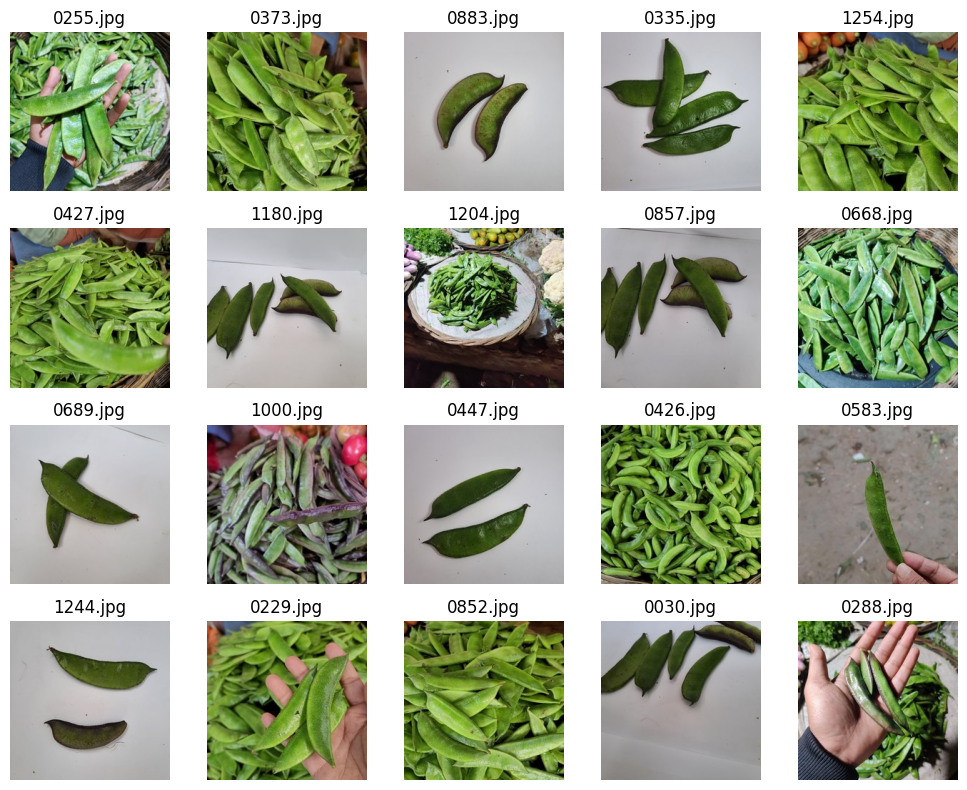

In [18]:
# visualize 'Bean' class
visualize_samples_by_label(train_df, 'Bean', num_samples=20)

**Characteristics**

Color : green

Shape: Beans are typically small, elongated, and have a curved shape.

Nutritional Value: Beans are known for their high nutritional value. They are a good source of plant-based protein, dietary fiber, vitamins (such as folate and vitamin B6), minerals (such as iron and magnesium), and antioxidants.

Reference : https://www.medicalnewstoday.com/articles/320192#benefits


## 2. Bitter Gourd

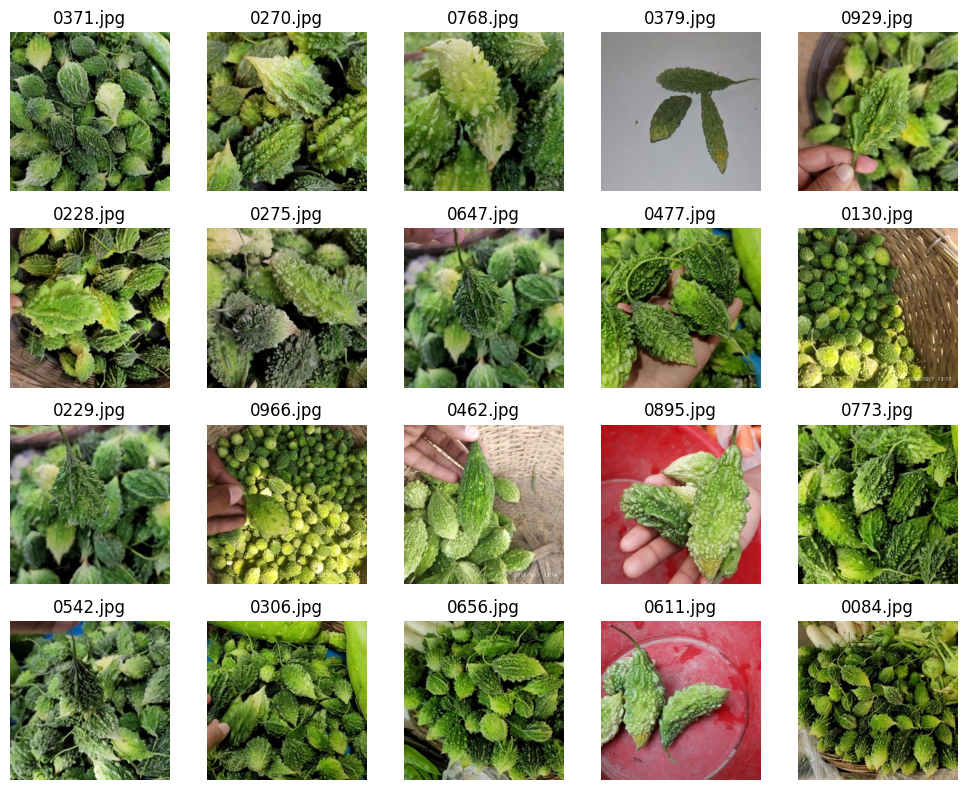

In [19]:
visualize_samples_by_label(train_df, 'Bitter_Gourd', num_samples=20)

**Characteristic**

Shape and Appearance: Bitter gourd has a long, elongated shape with a rough, bumpy skin. The surface of the vegetable is typically green, and it may have ridges or spikes along its length.

Color: Bitter gourds are generally green.

**Benefits**

Bitter melon may be associated with adverse side effects. Pregnant women, people with underlying health problems, and those taking blood sugar-lowering medications should consult their doctor before use.

https://www.healthline.com/nutrition/bitter-melon#TOC_TITLE_HDR_9

## 3. Bottle Gourd

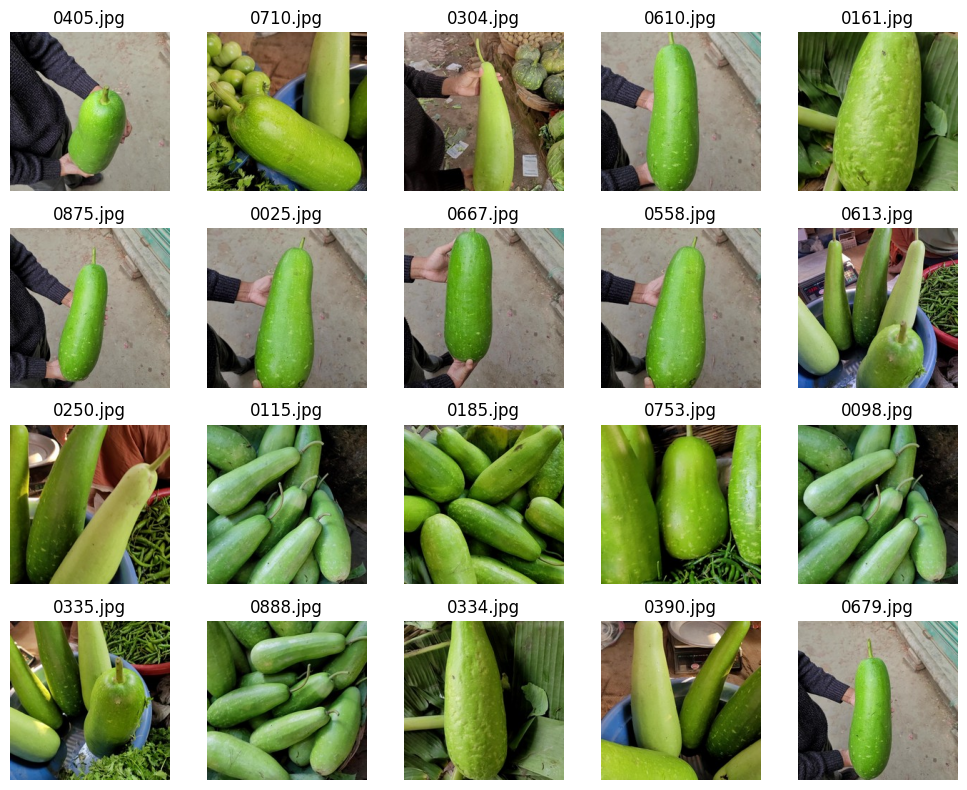

In [20]:
visualize_samples_by_label(train_df, 'Bottle_Gourd', num_samples=20)

**Characteristic**

Shape and Appearance: Bottle gourd has a unique elongated shape resembling a bottle or gourd.

Color : Color: Bottle gourd usually has a light green or pale green color.

**Benefit**

Reduces stress, Benefits the heart, Helps in weight loss, Helps in treating sleeping disorders.


https://indianexpress.com/article/lifestyle/food-wine/health-benefits-of-the-lauki-5245683/


## 4. Brinjal

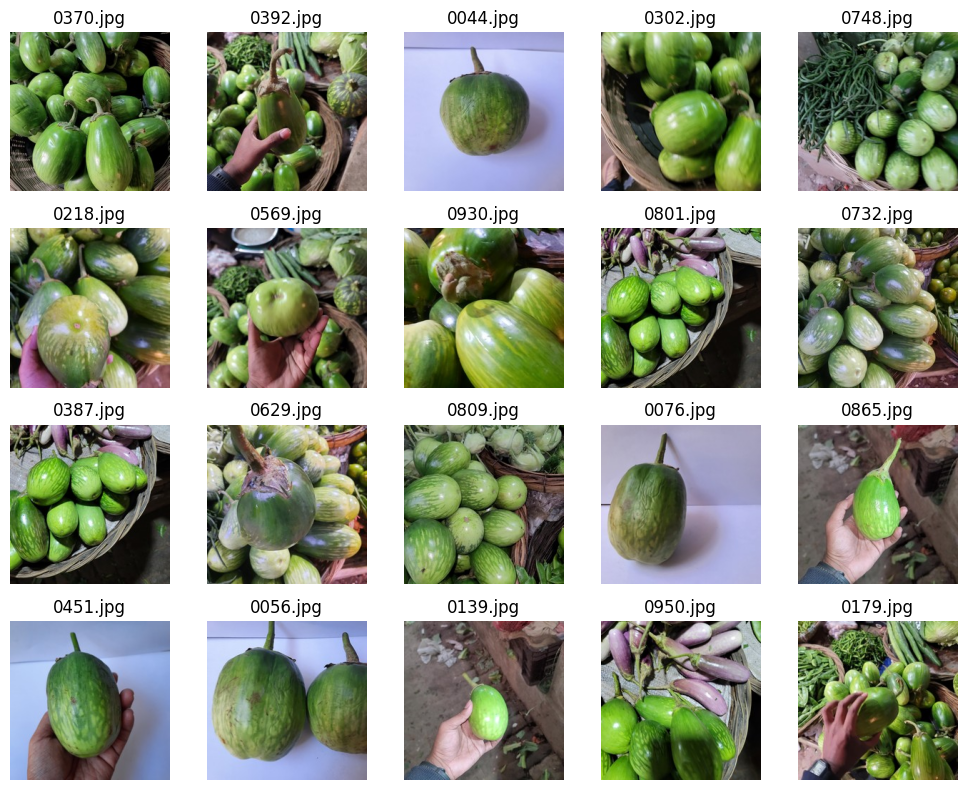

In [21]:
visualize_samples_by_label(train_df, 'Brinjal', num_samples=20)

**Characteristic**

Shape and Size: Brinjal has an elongated or oval shape with a smooth and shiny skin. The size can vary, ranging from small to large, depending on the variety. Some varieties may have a round or cylindrical shape.

Color: Brinjal comes in a variety of colors, including dark purple, light purple, green, white, and even striped or mottled combinations of these colors. The color may vary depending on the specific variety and stage of ripeness.

but in dataset used green Brinjal

**Benefit:**

Eggplant is high in fiber but low in calories, both of which can help promote weight loss. It can also be used in place of higher-calorie ingredients.

https://www.healthline.com/nutrition/eggplant-benefits#TOC_TITLE_HDR_6

## 5. Broccoli

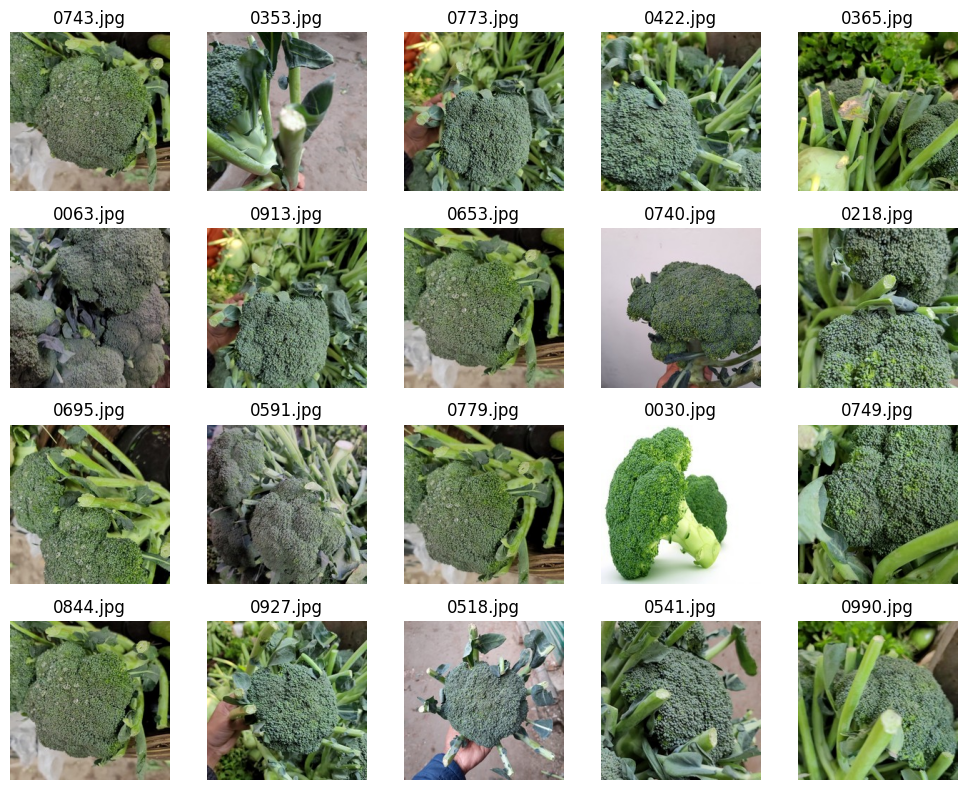

In [22]:
visualize_samples_by_label(train_df, 'Broccoli', num_samples=20)

**Characteristic**

Appearance: Broccoli has a distinctive appearance, with a compact head composed of numerous small, tightly packed flower buds called florets. The florets are attached to a thick, edible stalk. The color of broccoli can range from dark green to bluish-green.

Shape: The head of broccoli is typically rounded or dome-shaped, resembling a small tree or bush. The florets form a clustered shape that extends from the stalk.

Color: The florets of broccoli are dark green in color, while the stalk is lighter green. Some varieties of broccoli may have purple or yellowish-green florets.


**Benefit:**

Broccoli is high in many vitamins and minerals, including folate, potassium, manganese, and vitamins C and K1.

https://www.healthline.com/nutrition/foods/broccoli#plant-compounds

## 6. Cabbage

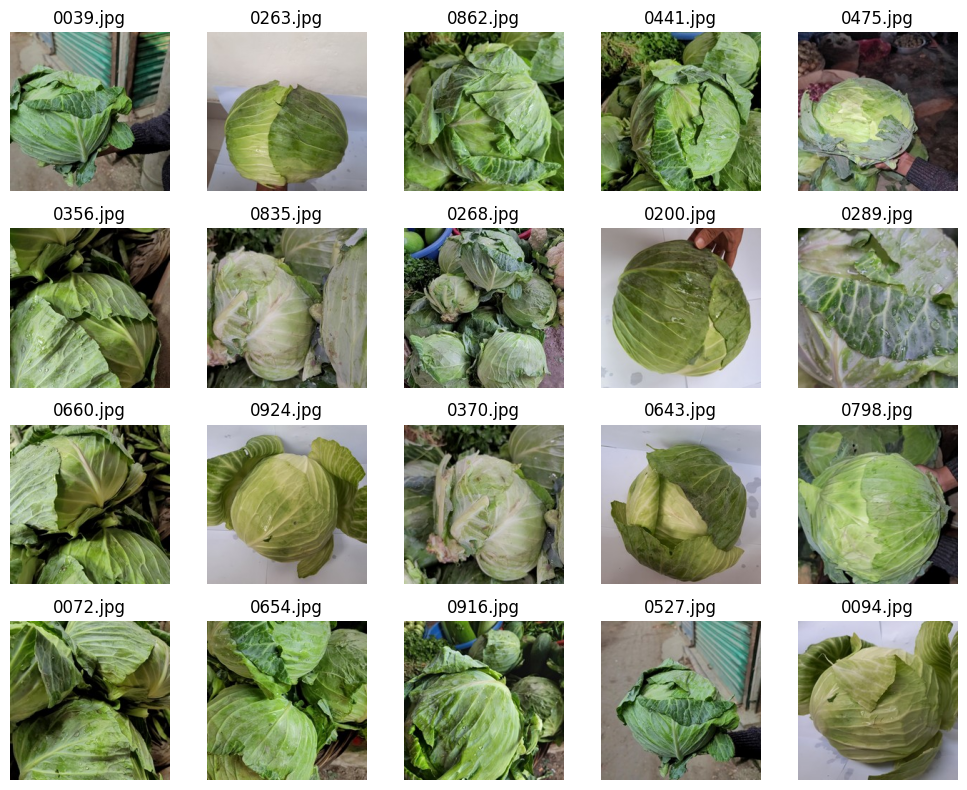

In [23]:
visualize_samples_by_label(train_df, 'Cabbage', num_samples=20)

**Characteristic**

Appearance: Cabbage has a compact, round or oval-shaped head composed of thick, overlapping leaves. The outer leaves are typically darker in color, ranging from light to dark green or even purple, while the inner leaves are lighter in color.

Texture: Cabbage leaves are crisp and crunchy, especially when consumed raw or lightly cooked. The texture becomes softer when cooked for a longer period.

Shape: The shape of cabbage can vary based on the variety. Common shapes include round, flattened, or pointed heads. Some varieties, such as Napa cabbage, have elongated, cylindrical-shaped heads.

Color: Cabbage can come in different colors, including green, red, and purple. The color is mainly determined by the pigments present in the leaves.

but in datasets only have `Green Cabbage`

**Benefits**

Cabbage is a low calorie vegetable that is rich in vitamins, minerals, and antioxidants.

https://www.healthline.com/nutrition/benefits-of-cabbage#TOC_TITLE_HDR_2


## 7. Capsicum

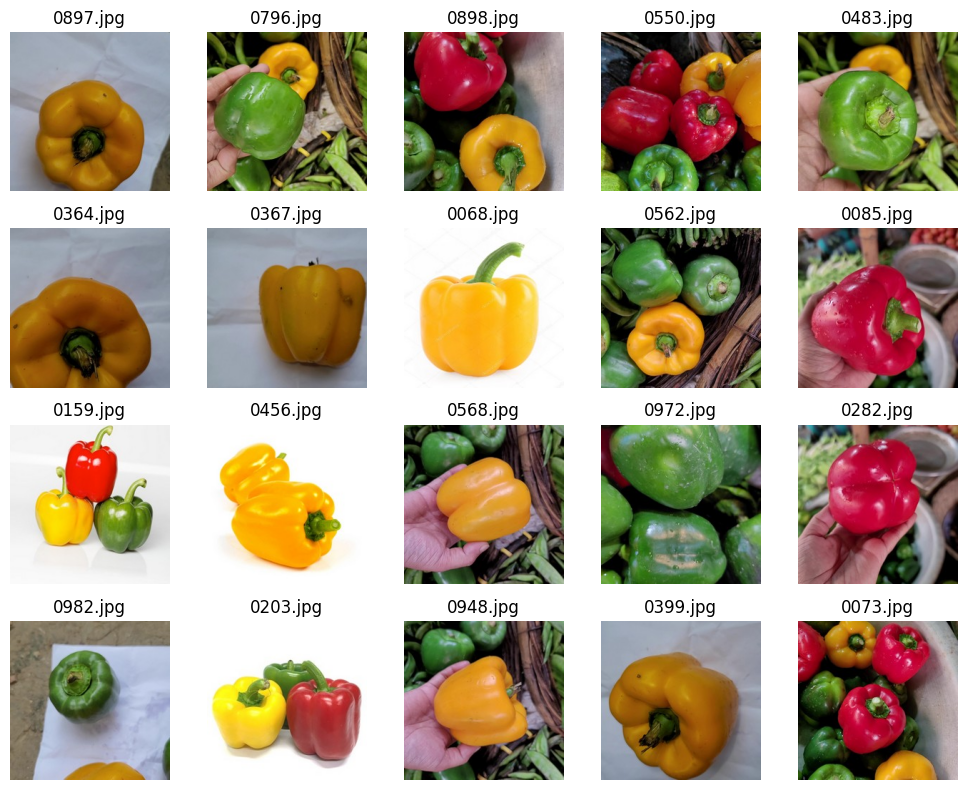

In [24]:
visualize_samples_by_label(train_df, 'Capsicum', num_samples=20)

**Characteristic**

Appearance: Capsicum comes in different colors, including green, red, yellow, orange, and even purple or brown. It has a thick, crisp, and glossy skin with a bell-like or blocky shape. The size and shape can vary depending on the variety.

Texture: Capsicum has a crunchy and crisp texture, particularly when eaten raw. The flesh is thick and juicy.

Shape: Capsicum typically has a three or four-lobed shape, although some varieties may have a more elongated or pointed shape. The bottom of the capsicum is flat, allowing it to stand upright.

Color: Green, Yellow, Red

**Benefits**

Capsicum is rich in antioxidants, which help protect the body against cellular damage caused by free radicals. It is also known for its potential anti-inflammatory properties and may have beneficial effects on heart health and immune function. Capsicum is low in calories and can be a valuable addition to a healthy diet.


https://www.healthifyme.com/blog/capsicum/

## 8. Carrot

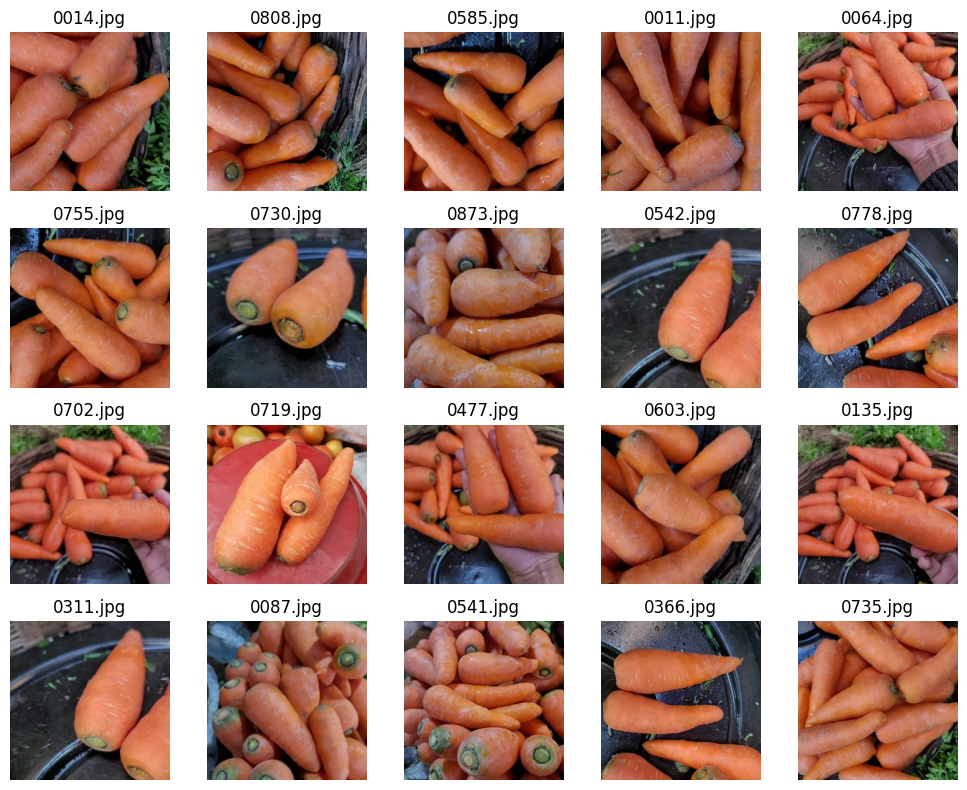

In [25]:
visualize_samples_by_label(train_df, 'Carrot', num_samples=20)

**Characteristic**

Size: Carrots come in various sizes, ranging from small baby carrots to larger ones. The size can vary depending on the variety and stage of growth.

Color : Mostly orange

**Benefits**

Carrots are about 10% carbs, consisting of starch, fiber, and simple sugars. They are extremely low in fat and protein.

https://www.healthline.com/nutrition/foods/carrots#nutrition

## 9. Cauliflower

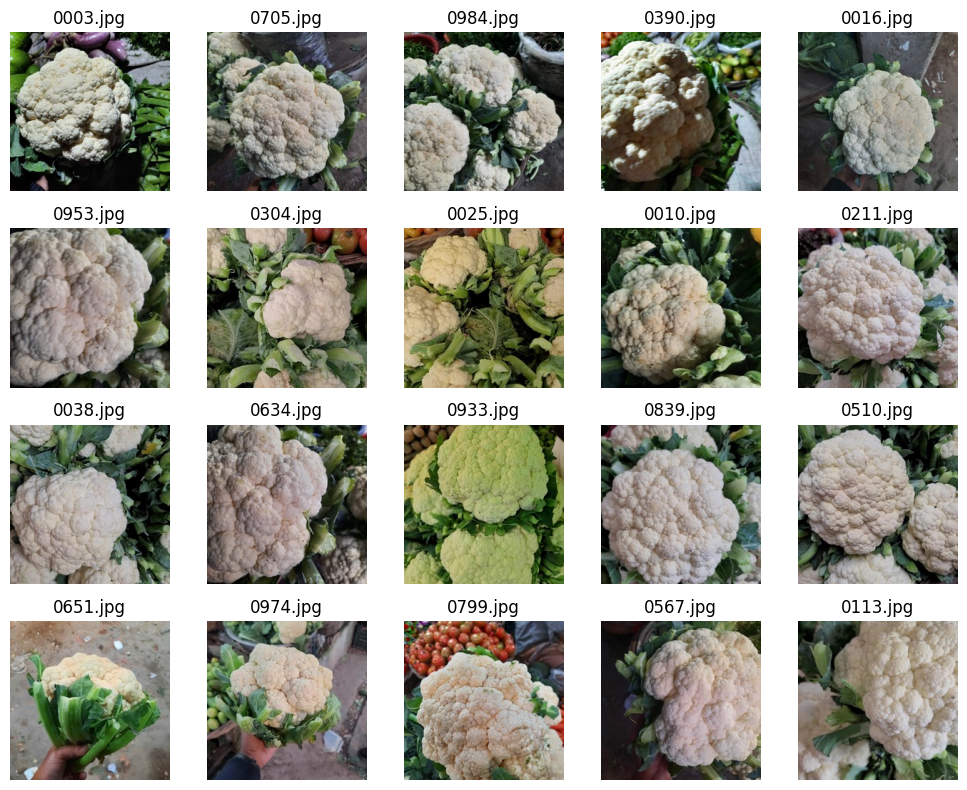

In [26]:
visualize_samples_by_label(train_df, 'Cauliflower', num_samples=20)

**Characteristic**

Appearance: Cauliflower has a compact head or "curd" composed of tightly clustered florets. The florets are attached to a thick, central stalk. The size of the head can vary, but it is generally round and resembles a white, cream, or light green-colored flower.

Color: The most common color of cauliflower is white, which is the result of the curd being shielded from sunlight during growth, preventing the development of chlorophyll. 

**Benefits**

Cauliflower is an excellent source of vitamins and minerals, including vitamin C, folate, and vitamin K.

https://www.healthline.com/nutrition/benefits-of-cauliflower#TOC_TITLE_HDR_2

## 10. Cucumber

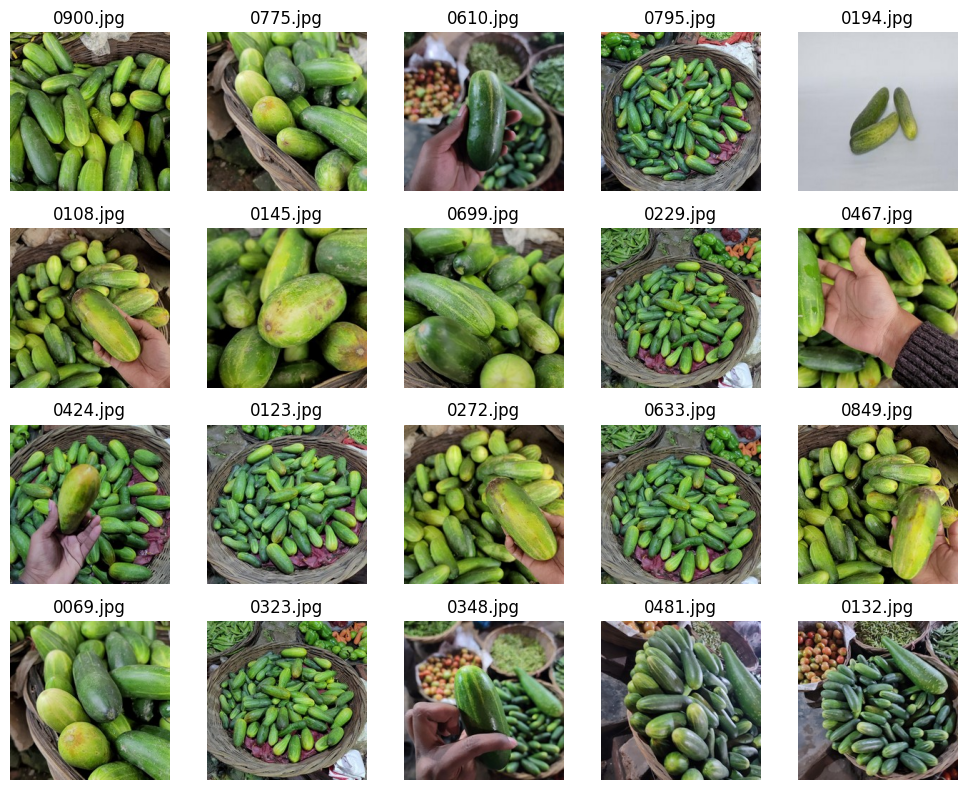

In [27]:
visualize_samples_by_label(train_df, 'Cucumber', num_samples=20)

**Characteristic**

Shape and Size: Cucumbers have a cylindrical shape with a length ranging from a few inches to several feet, depending on the variety. They typically have a smooth, waxy skin and are elongated in shape.

Color: The color of cucumbers can vary, but the most common variety is green. However, there are also other types of cucumbers, such as lemon cucumbers, which are yellow and round in shape.

**Benefits**

Cucumbers are low in calories but high in water and several important vitamins and minerals. Eating cucumbers with the peel provides the maximum amount of nutrients

https://www.healthline.com/nutrition/7-health-benefits-of-cucumber#TOC_TITLE_HDR_2

## 11. Papaya

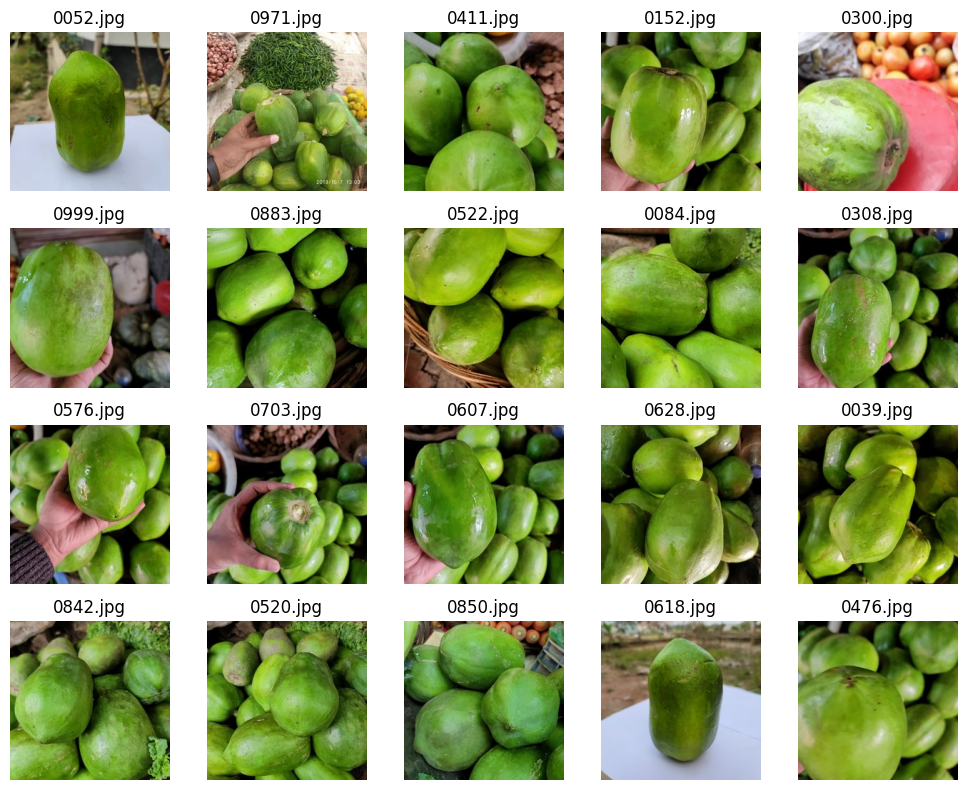

In [28]:
visualize_samples_by_label(train_df, 'Papaya', num_samples=20)

**Characteristic**

Skin: The outer skin of a papaya is thin and smooth. The color of the skin can vary depending on the variety and ripeness of the fruit.

Color : Green

**Benefits**

The papaya is a tropical fruit high in
vitamins C and A, as well as fiber and healthy plant compounds. It also
contains an enzyme called papain, used to tenderize meat.

https://www.healthline.com/nutrition/8-proven-papaya-benefits#TOC_TITLE_HDR_2

## 12. Potato

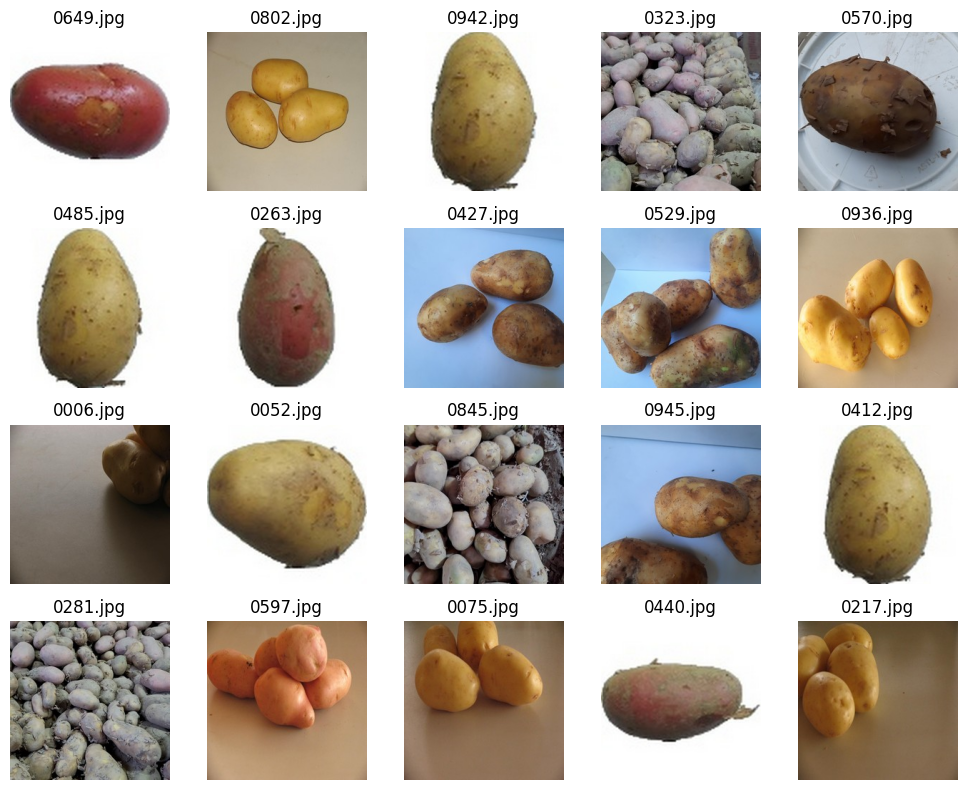

In [29]:
visualize_samples_by_label(train_df, 'Potato', num_samples=20)

**Characteristic**

Shape and Size: Potatoes come in various shapes and sizes, depending on the variety. They can be round, oval, or elongated. The size can range from small, bite-sized potatoes to large ones.

Skin: The skin of a potato can vary in color and texture. Common skin colors include brown, yellow, red, and even purple. The skin is thin and can be smooth or slightly rough, depending on the variety.

**Benefits**

Potatoes are a good
source of antioxidants, which may reduce the risk of chronic diseases like
heart disease, diabetes and certain cancers. However, more human-based research
is required before making any recommendations.

https://www.healthline.com/nutrition/benefits-of-potatoes#TOC_TITLE_HDR_3

## 13. Pumpkin

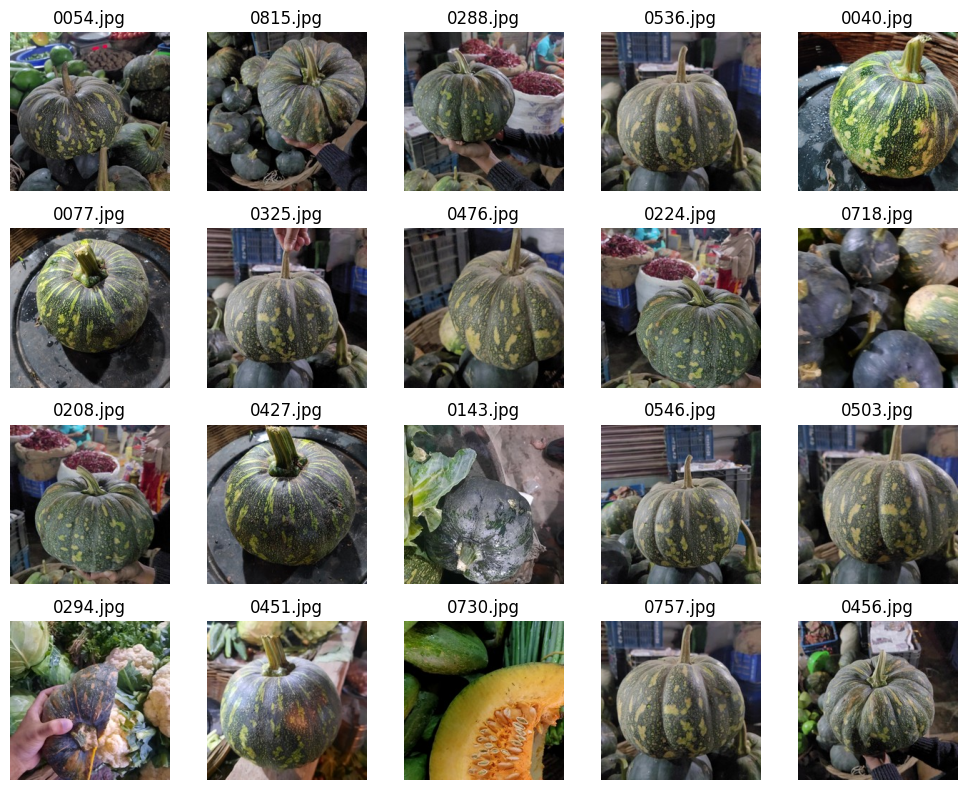

In [30]:
visualize_samples_by_label(train_df, 'Pumpkin', num_samples=20)

**Characteristic**

Shape and Size: Pumpkins typically have a round or oval shape, although there are also elongated varieties. They come in various sizes, ranging from small to large, with some giant varieties weighing several hundred pounds.

Color : Green

**Benefits**

is high in vitamins and minerals while being low in calories. It’s also a great
source of beta-carotene, a carotenoid that your body converts into vitamin A

https://www.healthline.com/nutrition/pumpkin#TOC_TITLE_HDR_2

## 14. Radish

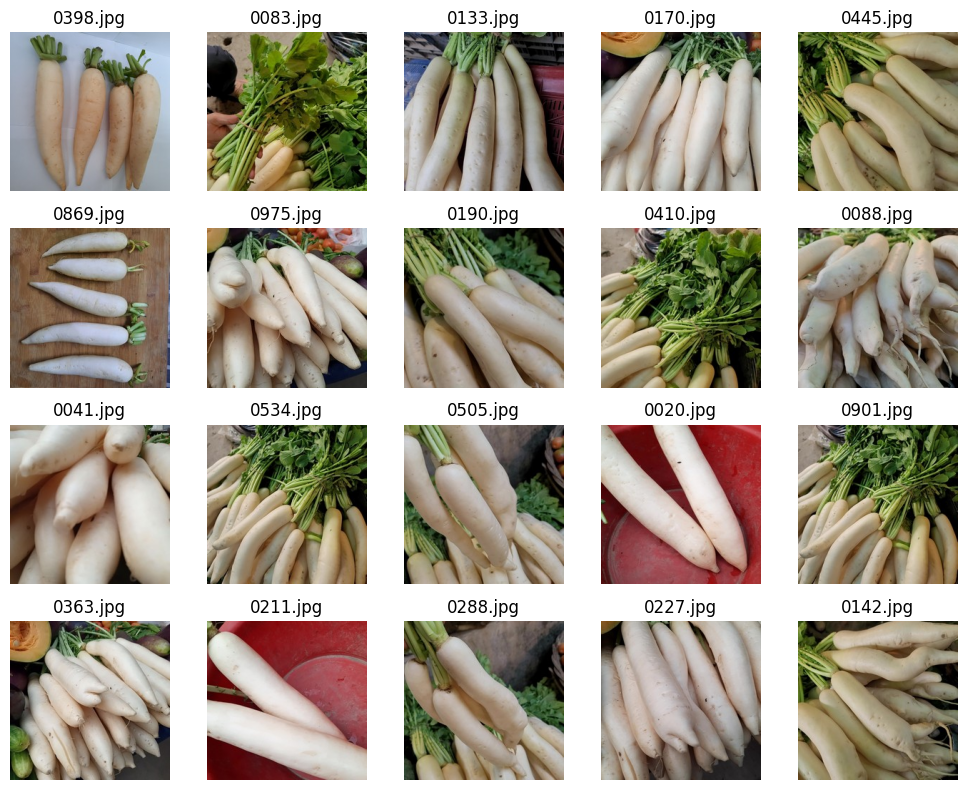

In [31]:
visualize_samples_by_label(train_df, 'Radish', num_samples=20)

**Characteristic**

Shape and Size: Radishes come in various shapes and sizes, ranging from small to medium-sized. The most common shape is round, but they can also be elongated or cylindrical.

Skin and Color: Radishes have thin, edible skin that can be smooth or slightly rough. The color of the skin can range from white and cream.

**Benefits**

Good for heart health, A source of antioxidants, May have anti-fungal properties.

https://www.bbcgoodfood.com/howto/guide/top-5-health-benefits-of-radishes

## 15. Tomato

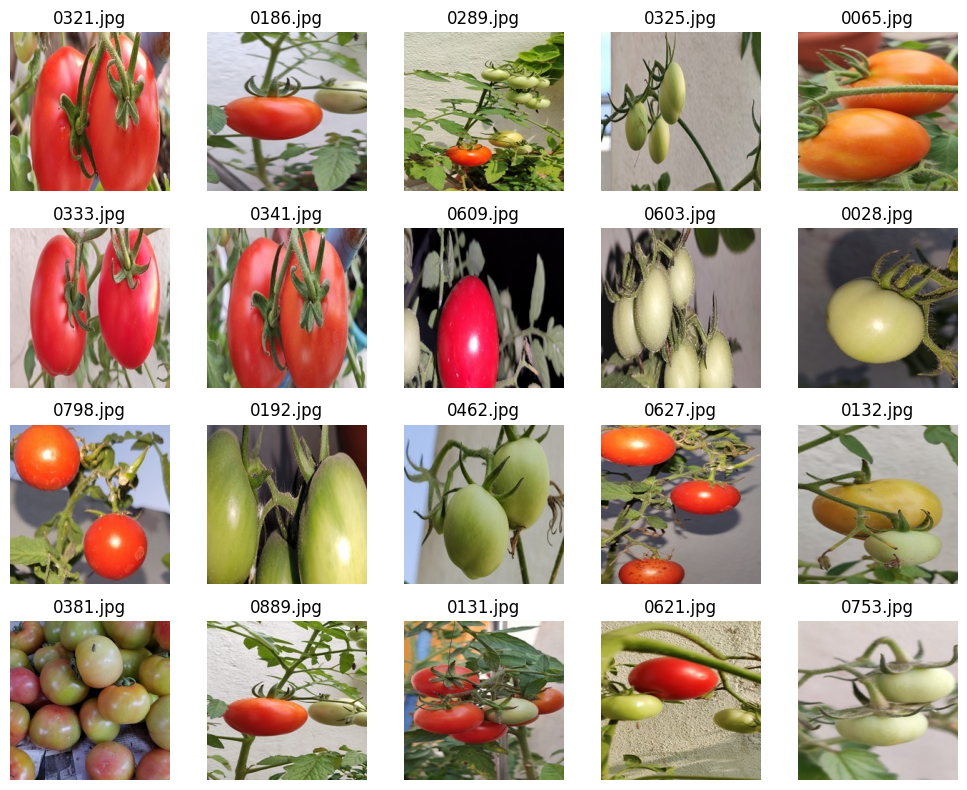

In [32]:
visualize_samples_by_label(train_df, 'Tomato', num_samples=20)

**Characteristic**

Shape and Size: Tomatoes come in a variety of shapes and sizes, depending on the cultivar. They can be round, oval, or slightly elongated. The size of tomatoes can range from small cherry tomatoes to large beefsteak tomatoes.

Skin and Color: The skin of tomatoes is smooth and thin. The color of the skin can vary depending on the variety and ripeness. Common colors include red, yellow, orange, green, and even purple or black for some heirloom varieties.

**Benefits**

Fresh tomatoes are low in carbs. The carb content consists mainly of simple sugars and insoluble fibers. These fruits are mostly made up of water.

https://www.healthline.com/nutrition/foods/tomatoes#nutrition

## Analysis

Mostly Vegetable in Datasets have a `Green` colors and Many Vegetables have same color such as papaya, cucumber, cabbage.

Some vegetables also have different colors such as : Tomato have a 3 colors, Potato have 3 colors, Capsicum have 3 colors and Broccoli have 2 colors

Mostly in datasets is just have Unpeeled Vegetables. 

# 5 - Feature Engineering

## 5.1 - Split feature (x) and Target (y)

In [33]:
# feature
X = 'images'
# target
y= 'label'

## 5.2 - Split train, test, and val data

Datasets is already have train, test, and validation.

we just see the data

In [34]:
# show Data
print('Size train: ', train_df.shape)
print('Size validation: ', val_df.shape)
print('Size test: ', test_df.shape)
print('Size Inference', inf_df.shape)

Size train:  (15000, 2)
Size validation:  (3000, 2)
Size test:  (2940, 2)
Size Inference (60, 2)


## 5.3 - Augmentation

In [35]:
# Define setting picture

img_height= 110 # set hight image
img_width= 110  # set width image
seed=7
batch_size= 32
input=[img_height,img_width,3]

In [36]:
# Augmentation Data

train_datagen = ImageDataGenerator(
              rescale= 1./255,        # This line scales down the pixel values of the images to the range of 0 to 1 by dividing them by 255.
              rotation_range= 0.1,    # Rotation is applied to the images within a range of 0.1 radians.
              width_shift_range= 0.2, # horizontal shifts can be applied to the images within a range of 20% of the total width.
              shear_range= 0.2,       # Shear transformations can be applied to the images within a range of 20%.
              zoom_range= 0.2,        # Zooming can be applied to the images within a range of 20%. It can zoom in or out on the objects within the images.
              horizontal_flip= True,  # Horizontal flips can be applied to the images with a 50% chance. It horizontally mirrors the images.
              vertical_flip = True    # Vertical flips can be applied to the images with a 50% chance. It vertically mirrors the images.
              )


In [37]:
# for validation data only use rescale
val_datagen = ImageDataGenerator(rescale=1./255)

# for test data only use rescale 
test_datagen = ImageDataGenerator(rescale=1./255)

In [38]:
# train data 
ds_train = train_datagen.flow_from_dataframe(
    dataframe=train_df,
    x_col='images',
    y_col='label',
    target_size=(img_height, img_width),
    class_mode='sparse',
    batch_size=batch_size,
    shuffle=False,
    seed=seed)

# validation data
ds_val = val_datagen.flow_from_dataframe(
    dataframe=val_df,
    x_col='images',
    y_col='label',
    target_size=(img_height, img_width),
    class_mode='sparse',
    batch_size=batch_size,
    shuffle=False,
    seed=seed)

# test data
ds_test = test_datagen.flow_from_dataframe(
    dataframe=test_df,
    x_col='images',
    y_col='label',
    target_size=(img_height, img_width),
    class_mode='sparse',
    batch_size=batch_size,
    shuffle=False,
    seed=seed)

Found 15000 validated image filenames belonging to 15 classes.
Found 3000 validated image filenames belonging to 15 classes.
Found 2940 validated image filenames belonging to 15 classes.


In [39]:
# load class
ds_train.class_indices

{'Bean': 0,
 'Bitter_Gourd': 1,
 'Bottle_Gourd': 2,
 'Brinjal': 3,
 'Broccoli': 4,
 'Cabbage': 5,
 'Capsicum': 6,
 'Carrot': 7,
 'Cauliflower': 8,
 'Cucumber': 9,
 'Papaya': 10,
 'Potato': 11,
 'Pumpkin': 12,
 'Radish': 13,
 'Tomato': 14}

# 6. - Model Definition

In [40]:
# create callbacks

callbacks = [
    EarlyStopping(monitor='val_loss', patience = 3),
    ModelCheckpoint('model.hdf5', monitor='val_loss', save_best_only=True)
]

## 6.1 - Sequential

In [41]:
# Model Arsitecture
model= Sequential()

#Layer Conv 1,
model.add(Conv2D(filters=16, kernel_size=3, activation='relu',
                       input_shape=input))
model.add(MaxPooling2D(pool_size=2, strides=2))

#Layer Conv 2
model.add(Conv2D(filters=32, kernel_size=3, activation='relu', padding= 'same'))
model.add(MaxPooling2D(pool_size=2, strides=2))

#Flatten
model.add(Flatten())

#Hidden Layer
model.add(Dense(units=32, activation='relu'))

#Output Layer
model.add(Dense(units=15, activation='softmax'))

#Summary
model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 108, 108, 16)      448       
                                                                 
 max_pooling2d (MaxPooling2D  (None, 54, 54, 16)       0         
 )                                                               
                                                                 
 conv2d_1 (Conv2D)           (None, 54, 54, 32)        4640      
                                                                 
 max_pooling2d_1 (MaxPooling  (None, 27, 27, 32)       0         
 2D)                                                             
                                                                 
 flatten (Flatten)           (None, 23328)             0         
                                                                 
 dense (Dense)               (None, 32)                7

In [42]:
model.compile(optimizer='adam',
              loss=tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True),
              metrics=['accuracy'])

# 6.2 - Model Improvement

On Improvement model i using `Xception` in Transfer Learning. Because Xception is better than  ResNet50 and VGG16 to increase Accuracy  

Reference : Jurnal Teknik Informatika dan Sistem Informasi (JuTISI)

https://journal.maranatha.edu/index.php/jutisi/article/view/1501

In [43]:
# create Xception Model
pretrained_model = tf.keras.applications.Xception(include_top=False, 
                                                  input_shape=input,pooling='avg')
pretrained_model.trainable = False

83683744/83683744 [==============================] - 0s 0us/step


In [44]:
# Model Definition
model_tf= Sequential()
model_tf.add(pretrained_model) # add Xception for Transfer Learning

#fully connected layer
model_tf.add(Flatten())
model_tf.add(Dense(32, activation='relu')),
model_tf.add(Dense(units=15,activation='softmax'))

In [45]:
model_tf.compile(optimizer='adam',
              loss=tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True),
              metrics=['accuracy'])

In [46]:
model_tf.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 xception (Functional)       (None, 2048)              20861480  
                                                                 
 flatten_1 (Flatten)         (None, 2048)              0         
                                                                 
 dense_2 (Dense)             (None, 32)                65568     
                                                                 
 dense_3 (Dense)             (None, 15)                495       
                                                                 
Total params: 20,927,543
Trainable params: 66,063
Non-trainable params: 20,861,480
_________________________________________________________________


# 7 - Model Training

## 7.1 - Sequential

In [47]:
# Training Based Model
%%time
history= model.fit(ds_train, batch_size= batch_size, 
                           epochs= 20, validation_data= ds_val,
                           callbacks= callbacks)
     

Epoch 1/20
469/469 [==============================] - 91s 170ms/step - loss: 1.8025 - accuracy: 0.3751 - val_loss: 1.3134 - val_accuracy: 0.5167
Epoch 2/20
469/469 [==============================] - 79s 168ms/step - loss: 1.2502 - accuracy: 0.5641 - val_loss: 1.0817 - val_accuracy: 0.6253
Epoch 3/20
469/469 [==============================] - 78s 167ms/step - loss: 0.9947 - accuracy: 0.6708 - val_loss: 1.0229 - val_accuracy: 0.6620
Epoch 4/20
469/469 [==============================] - 78s 166ms/step - loss: 0.8105 - accuracy: 0.7292 - val_loss: 0.6963 - val_accuracy: 0.7677
Epoch 5/20
469/469 [==============================] - 86s 183ms/step - loss: 0.6951 - accuracy: 0.7733 - val_loss: 0.5874 - val_accuracy: 0.8130
Epoch 6/20
469/469 [==============================] - 79s 169ms/step - loss: 0.6126 - accuracy: 0.8009 - val_loss: 0.6494 - val_accuracy: 0.7787
Epoch 7/20
469/469 [==============================] - 79s 168ms/step - loss: 0.5598 - accuracy: 0.8215 - val_loss: 0.4518 - val_ac

## 7.2 - Improvement

In [48]:
# Training Improvement Model
%%time
history4= model_tf.fit(ds_train, batch_size= batch_size, 
                           epochs= 20, validation_data= ds_val,
                           callbacks= callbacks)

Epoch 1/20
469/469 [==============================] - 93s 187ms/step - loss: 0.4921 - accuracy: 0.8519 - val_loss: 0.1741 - val_accuracy: 0.9473
Epoch 2/20
469/469 [==============================] - 86s 184ms/step - loss: 0.2092 - accuracy: 0.9339 - val_loss: 0.1348 - val_accuracy: 0.9607
Epoch 3/20
469/469 [==============================] - 92s 195ms/step - loss: 0.1650 - accuracy: 0.9478 - val_loss: 0.1066 - val_accuracy: 0.9667
Epoch 4/20
469/469 [==============================] - 89s 190ms/step - loss: 0.1419 - accuracy: 0.9568 - val_loss: 0.0815 - val_accuracy: 0.9747
Epoch 5/20
469/469 [==============================] - 88s 188ms/step - loss: 0.1321 - accuracy: 0.9567 - val_loss: 0.0888 - val_accuracy: 0.9727
Epoch 6/20
469/469 [==============================] - 88s 187ms/step - loss: 0.1128 - accuracy: 0.9633 - val_loss: 0.0746 - val_accuracy: 0.9793
Epoch 7/20
469/469 [==============================] - 88s 188ms/step - loss: 0.1092 - accuracy: 0.9649 - val_loss: 0.0782 - val_ac

# 8 - Model Evaluation

## 8.1 - Sequential

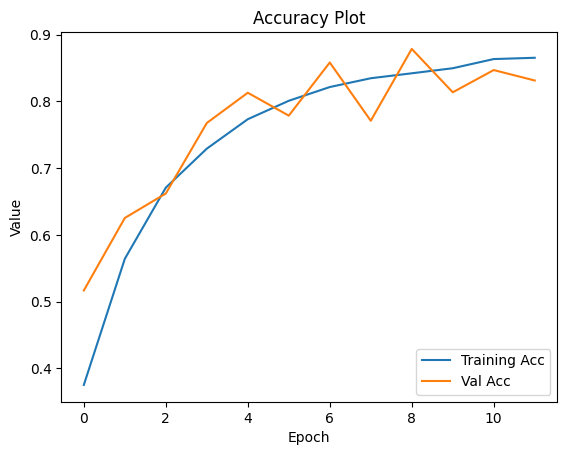

In [49]:
# plot result Based Model

plt.plot(history.history['accuracy'], label='Training Acc')
plt.plot(history.history['val_accuracy'], label='Val Acc')
plt.title('Accuracy Plot')
plt.ylabel('Value') 
plt.xlabel('Epoch')
plt.legend(loc='lower right')
plt.show()

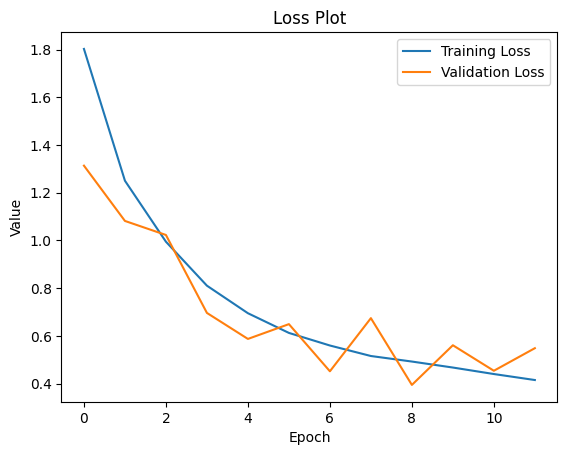

In [50]:
#loss train & validation
plt.plot(history.history['loss'], label='Training Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.title('Loss Plot')
plt.ylabel('Value')
plt.xlabel('Epoch')
plt.legend(loc="upper right")
plt.show()

In [51]:
# result Loss and Accuracy
test_results = model.evaluate(ds_test, verbose=0)
print(f'Test Loss     : {test_results[0]:.4f}')
print(f'Test Accuracy : {test_results[1]:.4f}')

Test Loss     : 0.5421
Test Accuracy : 0.8265


Based on the graph and results, the model has a significant loss and low accuracy rate.

In [52]:
# Predict test data
prediction = model.predict(ds_test)

92/92 [==============================] - 5s 56ms/step


In [53]:
y_pred = np.argmax(model.predict(ds_test), axis=-1)
y_pred

92/92 [==============================] - 6s 68ms/step


array([ 2,  8,  8, ...,  3, 13,  2])

In [54]:
# create class name 
class_names = ["Bean", "Bitter_Gourd", "Bottle_Gourd", "Brinjal", "Broccoli",
               "Cabbage", "Capsicum", "Carrot", "Cauliflower", "Cucumber", "Papaya", "Potato", "Pumpkin", "Radish","Tomato"]

In [55]:
class_names

['Bean',
 'Bitter_Gourd',
 'Bottle_Gourd',
 'Brinjal',
 'Broccoli',
 'Cabbage',
 'Capsicum',
 'Carrot',
 'Cauliflower',
 'Cucumber',
 'Papaya',
 'Potato',
 'Pumpkin',
 'Radish',
 'Tomato']

In [56]:
# change number to string in class
y_pred1=np.array(class_names)[y_pred]

In [57]:
y_pred1

array(['Bottle_Gourd', 'Cauliflower', 'Cauliflower', ..., 'Brinjal',
       'Radish', 'Bottle_Gourd'], dtype='<U12')

In [58]:
# create dataframe to save prediction
pred_result_pred = pd.DataFrame(y_pred1, columns=['y_pred'])

In [59]:
pred_result_pred

,y_pred
0,Bottle_Gourd
1,Cauliflower
2,Cauliflower
3,Pumpkin
4,Bitter_Gourd
...,...
2935,Broccoli
2936,Cauliflower
2937,Brinjal
2938,Radish


In [60]:
# reset index
test_df_reset = test_df.reset_index(drop=True)


In [61]:
test_df_reset

,images,label
0,/content/images/Vegetable Images/test/Bottle_G...,Bottle_Gourd
1,/content/images/Vegetable Images/test/Cauliflo...,Cauliflower
2,/content/images/Vegetable Images/test/Cauliflo...,Cauliflower
3,/content/images/Vegetable Images/test/Pumpkin/...,Pumpkin
4,/content/images/Vegetable Images/test/Cucumber...,Cucumber
...,...,...
2935,/content/images/Vegetable Images/test/Tomato/1...,Tomato
2936,/content/images/Vegetable Images/test/Cabbage/...,Cabbage
2937,/content/images/Vegetable Images/test/Brinjal/...,Brinjal
2938,/content/images/Vegetable Images/test/Bean/062...,Bean


In [62]:
# concat label and y_pred
result_model_pred1 = pd.concat([test_df_reset, pred_result_pred], axis=1)
result_model_pred1 = result_model_pred1.reset_index(drop=True)
result_model_pred1[['label', 'y_pred']]

,label,y_pred
0,Bottle_Gourd,Bottle_Gourd
1,Cauliflower,Cauliflower
2,Cauliflower,Cauliflower
3,Pumpkin,Pumpkin
4,Cucumber,Bitter_Gourd
...,...,...
2935,Tomato,Broccoli
2936,Cabbage,Cauliflower
2937,Brinjal,Brinjal
2938,Bean,Radish


Note : label (y_actual) in test data and y_pred(result prediction)

In [63]:
print('Best Model classification report test : \n',classification_report(result_model_pred1['label'], result_model_pred1['y_pred']))

Best Model classification report test : 
               precision    recall  f1-score   support

        Bean       0.63      0.88      0.73       195
Bitter_Gourd       0.59      0.94      0.73       194
Bottle_Gourd       0.87      0.86      0.86       196
     Brinjal       0.66      0.81      0.73       196
    Broccoli       0.84      0.77      0.81       198
     Cabbage       0.81      0.82      0.81       195
    Capsicum       0.98      0.94      0.96       191
      Carrot       0.97      0.95      0.96       194
 Cauliflower       0.82      0.91      0.86       196
    Cucumber       0.97      0.28      0.44       198
      Papaya       0.98      0.69      0.81       200
      Potato       0.97      0.97      0.97       198
     Pumpkin       0.88      0.92      0.90       198
      Radish       0.93      0.98      0.95       196
      Tomato       0.94      0.68      0.79       195

    accuracy                           0.83      2940
   macro avg       0.85      0.83     

<Axes: >

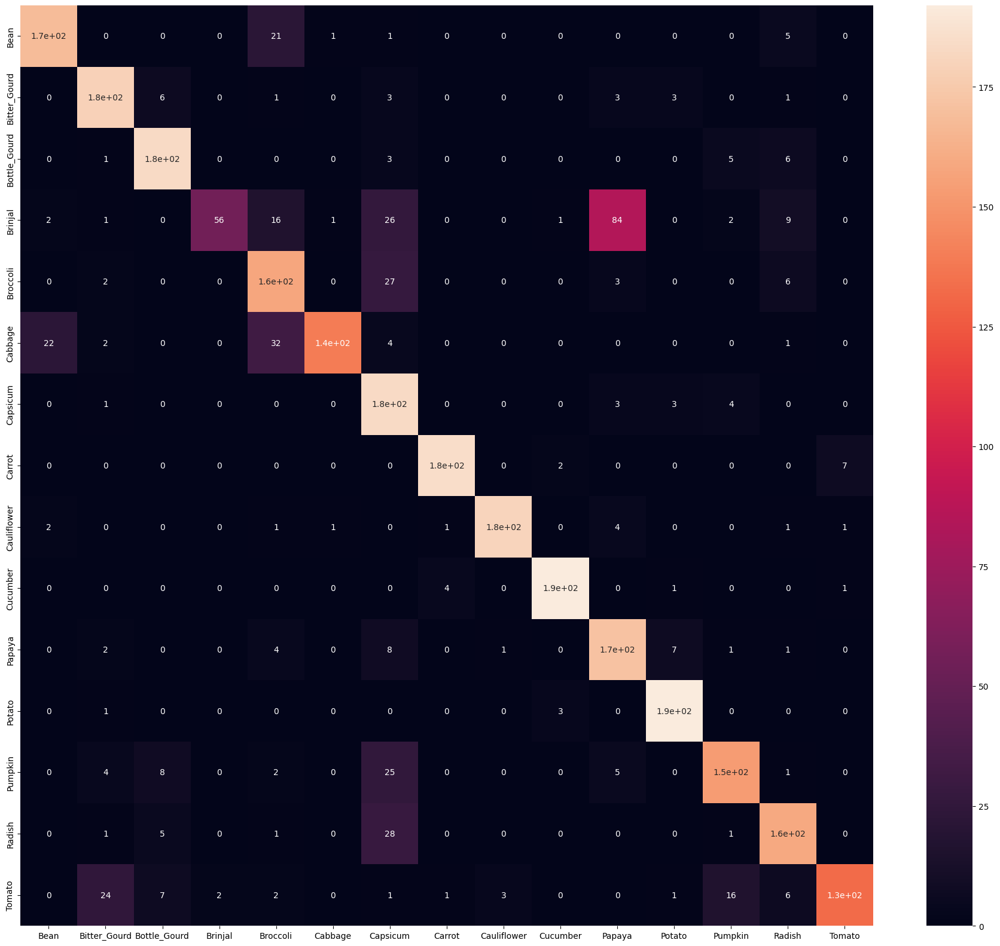

In [64]:
# Display Confussion Matrix

np.set_printoptions(suppress=True)

plt.figure(figsize=(23, 20))
model_confussionmatrix = confusion_matrix(result_model_pred1['label'], result_model_pred1['y_pred'], labels=result_model_pred1['label'].unique())
sns.heatmap(model_confussionmatrix, annot=True , xticklabels=class_names, yticklabels=class_names)

Based On confussion matriks There are still some errors prediction.

## 8.2 - Improvement

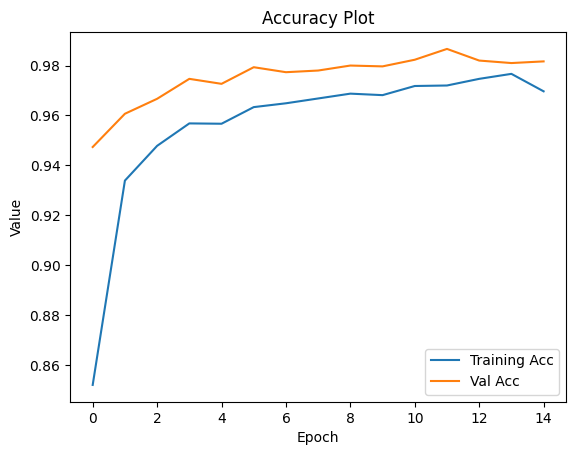

In [65]:
# plot resullt Imporvement Model
plt.plot(history4.history['accuracy'], label='Training Acc')
plt.plot(history4.history['val_accuracy'], label='Val Acc')
plt.title('Accuracy Plot')
plt.ylabel('Value') 
plt.xlabel('Epoch')
plt.legend(loc='lower right')
plt.show()

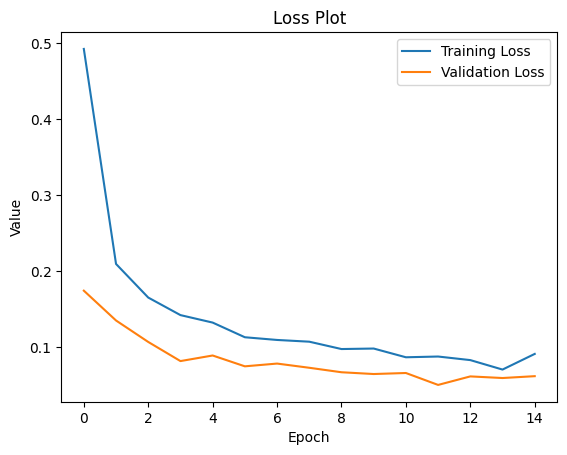

In [66]:
#loss train & validation
plt.plot(history4.history['loss'], label='Training Loss')
plt.plot(history4.history['val_loss'], label='Validation Loss')
plt.title('Loss Plot')
plt.ylabel('Value')
plt.xlabel('Epoch')
plt.legend(loc="upper right")
plt.show()

In [67]:
# resul Loss and Accuracy
test_results2 = model_tf.evaluate(ds_test, verbose=0)
print(f'Test Loss     : {test_results2[0]:.4f}')
print(f'Test Accuracy : {test_results2[1]:.4f}')

Test Loss     : 0.0634
Test Accuracy : 0.9799


Based on the graph and results, the model has a low loss rate and a high accuracy rate

In [68]:
# predict using Transfer learning model
prediction2 = model_tf.predict(ds_test)

92/92 [==============================] - 8s 72ms/step


In [69]:
y_pred2 = np.argmax(model_tf.predict(ds_test), axis=-1)
y_pred2

92/92 [==============================] - 7s 72ms/step


array([2, 8, 8, ..., 3, 0, 2])

In [70]:
# change number to string in class
y_pred2=np.array(class_names)[y_pred2]

In [71]:
y_pred2

array(['Bottle_Gourd', 'Cauliflower', 'Cauliflower', ..., 'Brinjal',
       'Bean', 'Bottle_Gourd'], dtype='<U12')

In [72]:
# create dataframe 
pred_result_pred2 = pd.DataFrame(y_pred2, columns=['y_pred_improve'])

In [73]:
pred_result_pred2

,y_pred_improve
0,Bottle_Gourd
1,Cauliflower
2,Cauliflower
3,Pumpkin
4,Cucumber
...,...
2935,Tomato
2936,Cabbage
2937,Brinjal
2938,Bean


In [74]:
# concat test data and result prediction
result_model_pred2 = pd.concat([test_df_reset, pred_result_pred2], axis=1)
result_model_pred2 = result_model_pred2.reset_index(drop=True)
result_model_pred2[['label', 'y_pred_improve']]


,label,y_pred_improve
0,Bottle_Gourd,Bottle_Gourd
1,Cauliflower,Cauliflower
2,Cauliflower,Cauliflower
3,Pumpkin,Pumpkin
4,Cucumber,Cucumber
...,...,...
2935,Tomato,Tomato
2936,Cabbage,Cabbage
2937,Brinjal,Brinjal
2938,Bean,Bean


Note : label (y_actual) in test data and y_pred_improve(result prediction using transfer learning Xception)

In [75]:
print('Best Model classification report test : \n',classification_report(result_model_pred2['label'], result_model_pred2['y_pred_improve']))

Best Model classification report test : 
               precision    recall  f1-score   support

        Bean       0.97      0.98      0.98       195
Bitter_Gourd       0.98      0.98      0.98       194
Bottle_Gourd       0.96      0.99      0.97       196
     Brinjal       0.90      0.98      0.94       196
    Broccoli       1.00      0.99      0.99       198
     Cabbage       0.97      1.00      0.98       195
    Capsicum       0.99      1.00      1.00       191
      Carrot       0.99      0.99      0.99       194
 Cauliflower       0.98      0.99      0.98       196
    Cucumber       0.99      0.94      0.96       198
      Papaya       1.00      0.89      0.94       200
      Potato       0.99      0.99      0.99       198
     Pumpkin       0.99      0.98      0.99       198
      Radish       0.99      0.99      0.99       196
      Tomato       0.99      0.99      0.99       195

    accuracy                           0.98      2940
   macro avg       0.98      0.98     

<Axes: >

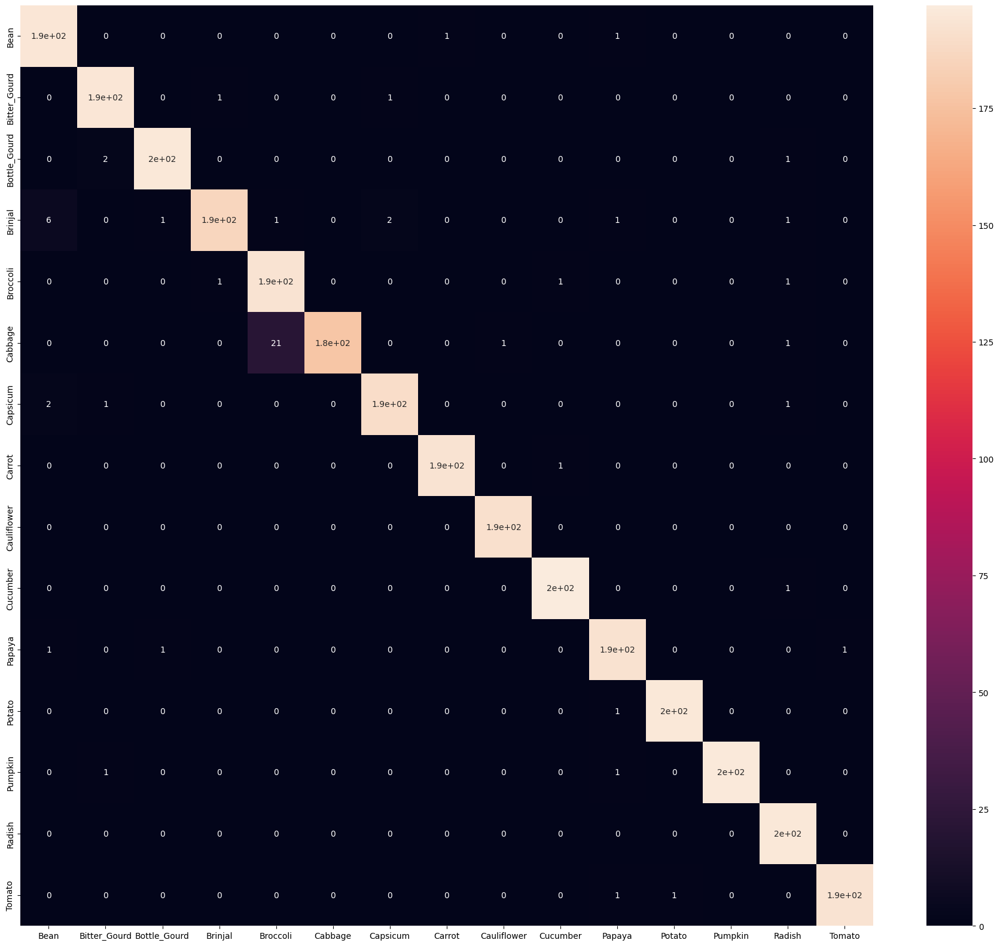

In [76]:
# Display Confussion Matrix

np.set_printoptions(suppress=True)

plt.figure(figsize=(23, 20))
model_confussionmatrix = confusion_matrix(result_model_pred2['label'], result_model_pred2['y_pred_improve'], labels=result_model_pred2['label'].unique())
sns.heatmap(model_confussionmatrix, annot=True , xticklabels=class_names, yticklabels=class_names)

Based on confussion matriks mostly model can predict correcly.

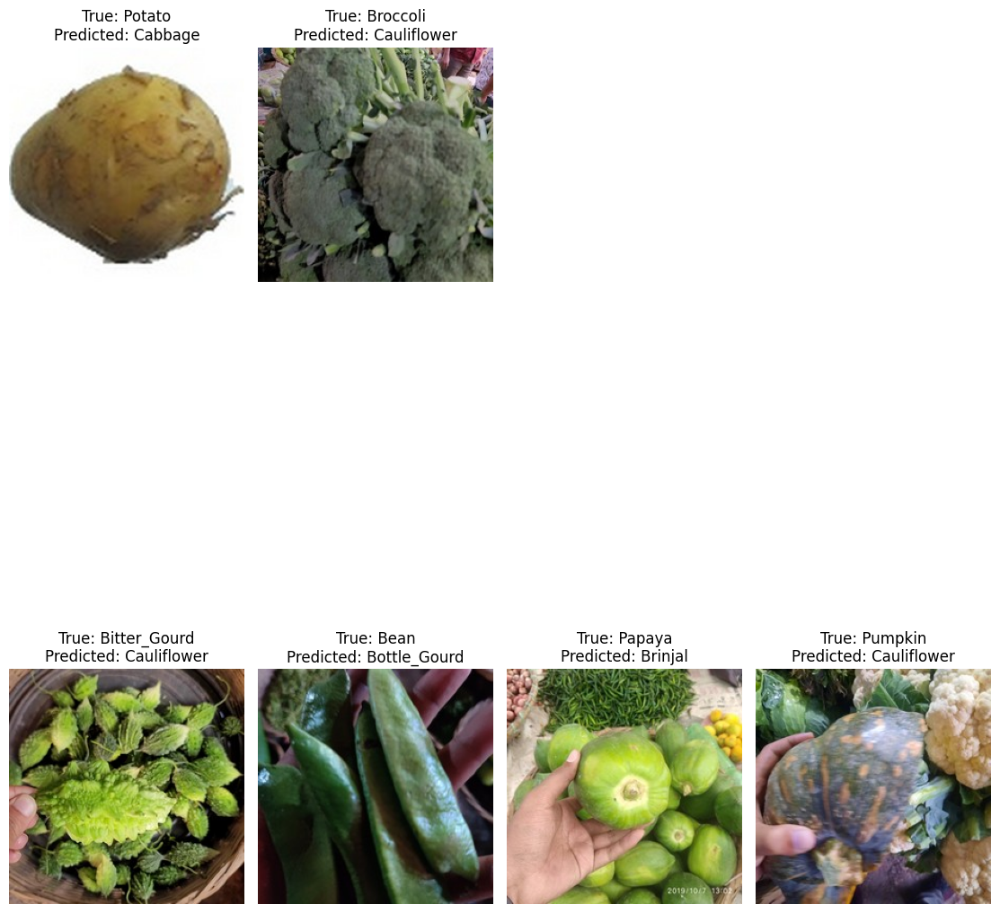

In [97]:
incorrect_predictions = result_model_pred2[result_model_pred2['label'] != result_model_pred2['y_pred_improve']].head(10)

plt.figure(figsize=(14, 14))
for i, row in incorrect_predictions.iterrows():
    image_path = row[test_df.columns.get_loc('images')]
    true_label = row['label']
    predicted_label = row['y_pred_improve']

    img = cv2.imread(image_path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

    plt.subplot(2, 5, i % 10 + 1)
    plt.imshow(img)
    plt.title(f'True: {true_label}\nPredicted: {predicted_label}')
    plt.axis('off')

plt.tight_layout()
plt.show()


The biggest mistake of the model is its failure to predict vegetables that have similar shapes and colors.

for exlample : 

Models failed to predict Brocoli, because Broccoli and Cauliflower is similiar shape.

# 9. Model Saving

Based on result Model Improvement is better than based model.

In [77]:
# Saving model
model_tf.save("best_model.h5")

# 10. Model Inference

In [122]:
import requests
urls = ['https://m.media-amazon.com/images/I/51mUwdp2THL._SL1100_.jpg',
        'https://www.thespruce.com/thmb/1muJtbSnWG6B3LSa2ZRM1Vl3RNk=/750x0/filters:no_upscale():max_bytes(150000):strip_icc():format(webp)/determinate-and-indeterminate-tomatoes-2540020-04-2e604edfd69c433a95255922236680cc.jpg',
        'https://www.allaboutgardening.com/wp-content/uploads/2022/02/Grow-Cabbage.jpg',
        'https://www.gardeningknowhow.com/wp-content/uploads/2021/07/papaya-690x518.jpg',
        'https://www.veggycation.com.au/siteassets/veggycationvegetable/capsicum-red.jpg']

for index, url in enumerate(urls):
  response = requests.get(url)
  filename = 'img-test-' + str(index+1) + '.jpg' 
  file = open(filename, "wb")
  file.write(response.content)
  file.close()

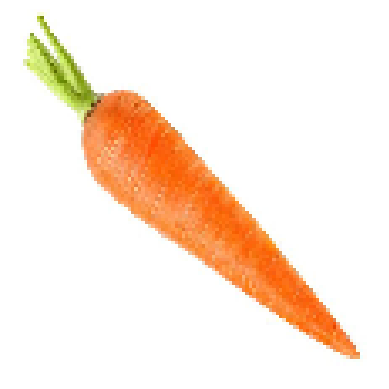

1/1 [==============================] - 0s 35ms/step
Result     :  [[0.06703483 0.00006269 0.00145304 0.00000196 0.00000306 0.00000045
  0.00000163 0.00097495 0.00000456 0.00001344 0.000004   0.00291296
  0.0013271  0.92619866 0.00000666]]
Max Class  :  13
Class Name :  Radish



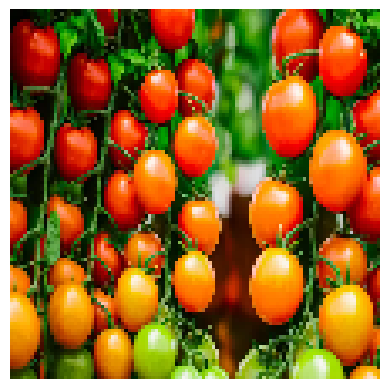

1/1 [==============================] - 0s 27ms/step
Result     :  [[0.00008949 0.00000003 0.00000001 0.00000006 0.         0.00000005
  0.00000008 0.00000027 0.00000003 0.00000269 0.         0.00000007
  0.00000002 0.00000001 0.99990726]]
Max Class  :  14
Class Name :  Tomato



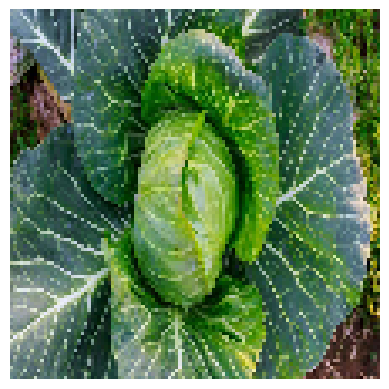

1/1 [==============================] - 0s 32ms/step
Result     :  [[0.00000001 0.00000034 0.00000004 0.00000058 0.00000022 0.96861666
  0.         0.         0.00024636 0.00002333 0.00000221 0.00000004
  0.03111019 0.00000001 0.        ]]
Max Class  :  5
Class Name :  Cabbage



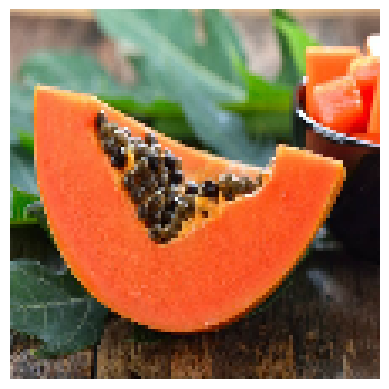

1/1 [==============================] - 0s 33ms/step
Result     :  [[0.00000056 0.00144864 0.00000855 0.         0.         0.
  0.         0.00123308 0.         0.00000094 0.         0.
  0.9971124  0.00002068 0.00017512]]
Max Class  :  12
Class Name :  Pumpkin



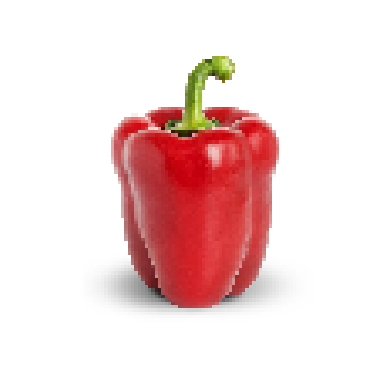

1/1 [==============================] - 0s 33ms/step
Result     :  [[0.00103474 0.00042675 0.0000784  0.05541715 0.01607809 0.00015881
  0.90607095 0.00009498 0.00001967 0.00109392 0.00820839 0.00298285
  0.00057665 0.00173951 0.00601909]]
Max Class  :  6
Class Name :  Capsicum



In [123]:
# Test Images

from tensorflow.keras.preprocessing import image

img_paths = ['img-test-1.jpg',
             'img-test-2.jpg',
             'img-test-3.jpg',
             'img-test-4.jpg',
             'img-test-5.jpg',]

for filename in img_paths:
  img = image.load_img(filename, target_size=(input))
  plt.imshow(img)
  plt.axis('off')
  plt.show()

  img_array = tf.keras.preprocessing.image.img_to_array(img)
  img_batch = np.expand_dims(img_array, axis=0)

  img_batch = img_batch / 255.0

  prediction_inf = model_tf.predict(img_batch)
  result_max_proba = prediction_inf.argmax(axis=-1)[0]
  result_class = class_names[result_max_proba]

  print('Result     : ', prediction_inf)
  print('Max Class  : ', result_max_proba)
  print('Class Name : ', result_class)
  print('')

## Evaluated Inferences

Picture 1 : Model failed to predict images that should have been carrots but instead predicted radishes. This is because radishes and carrots have similar sizes but only differ in color.

Picture 2 : Model successfully predicted tomatoes.

Picture 3 : Model succesfully predicted Cabbage.

Picture 4 : Model Failed to predict the papaya, because the dataset only contains unpeeled fruit data.

Picture 5 : Model succesfully to predicted Capsicum

# 11. Conclusion

## EDA

Many vegetable have a same colors and shape.

Mostly Vegetable in Datasets have a `Green` colors and Many Vegetables have same color such as papaya, cucumber, cabbage.

Some vegetables also have different colors such as : Tomato have a 3 colors, Potato have 3 colors, Capsicum have 3 colors and Broccoli have 2 colors

## Model

**baseline model :**

Test Loss     : 0.5421

Test Accuracy : 0.8265

**Improvement Model:**

Test Loss     : 0.0634

Test Accuracy : 0.9799

Improvement model is better than baseline model. Because on improvement model use XCeption in Transfer Learning. 

`Improvement is succesfully.`

## Summary Worksflow

Prepocessing : 

* in prepocessing using split data train, test, and validation. Test, train, and validation data are used in the process of developing machine learning models to measure performance and ensure that the built model can generalize well on new data.

* Augmentations using reslace, rotation range, width shift range, shear range, zoom range, horizontal flip, vertical flip. Overall, data augmentation is a useful technique for expanding training datasets, increasing data diversity, and increasing the robustness and generalizability of machine learning models.

Model Selected :

* Using Sequential API and Improvement Model using Transfer learning

* The number of neurons selected based on personal experience and assumptions.

* If the number of neurons is too large, it can cause the model to become overly complex and the computational process to become very time-consuming.

* Transfer learning used Xception .The Xception model leverages the concept of Inception, where each convolutional layer of a neural network is factored into a sequence of operations that exploit cross-channel correlations and partial correlations (length and width). With this Inception concept, the model's accuracy improves due to the use of more efficient model parameters (correlations).

reference : https://journal.maranatha.edu/index.php/jutisi/article/view/1501

## Advantages of the model:

* High accuracy prediction

* Large amount of training data

* There are 15 fruit classes that can be predicted.

## Model limitations:


*   The model may fail to predict peeled vegetables since the training data only consists of unpeeled vegetables.
*   The model is likely to struggle with predicting fruits that have a wide range of color variations.
*   The model can only predict fresh fruits; it may not perform well on rotten or spoiled fruits.
*   If fruits have the same shape and color, the model may also fail to predict accurately.
*   The Model only can predict 15 class of vegetables.

## Recommendation:

Add other types of vegetables to the dataset so that the model can predict a wider variety of vegetables.

Add training data for peeled vegetables.

Add training data for colors variant on each classes.

HuggingFace : https://huggingface.co/spaces/iqbal6661/vegetables_prediction

`Note : Run this Notebook on GoogleColab`